## data

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import time
import os

# our own pipeline
from pipelines.data_prapare import pack_data
from pipelines.tools import plot_intervals

from scipy.fft import fft, fftfreq
# Wavelets 
import pywt

In [2]:
import warnings
warnings.filterwarnings("ignore")

In [3]:
data_source_path = "./data/Tests_EEG_Lintao/"
filename_list = os.listdir("./data/Tests_EEG_Lintao/")
path_list = list()
for item in filename_list:
    path_list.append(os.path.join(data_source_path, item))

alphabet_list, asl_list, alphabet_vision, alphabet_imagination, asl_vision, asl_imagination = pack_data(path_list)

For now, except directly plotting signals, we can also get frequency power bands, we can try to do the function in OpenBCI GUI - Head plot,we can also use the method in other papers.

but remember, we still need to consider data augmentation for our data!

## Filter

See more details in 01 notebook, see codes about downsample, transforms(fft, wavelt), filters(bandpass, bandstop, highpass, lowpass)

If need, we can integrate all those process as a pipeline in a py file

## Frequency power bands

See more details in 02 notebook(original ref https://raphaelvallat.com/bandpower.html)


Raw time series data has excellent temporal (time axis) accuracy, but has no information on frequency because it is raw data.

* Fast Fourier Transform 

* Wavelet Transform

* Welch

* Multidaper


In [4]:
delta_BP = (0.5,4) # (0.1,4) (0.3, 4)
theta_BP = (4,8) 
alpha_BP = (8,13) 
beta_BP= (13,30)  # (13,32)
gamma_BP = (30,100) # (32, 100) (32, inf)

In [5]:
alphabet_1 = alphabet_vision[0]

# alphabet_1
# (0, (2283, 2642), 'vision', 'alphabet', 9, 'I')

example = alphabet_list[0].iloc[2283:2643,0:16]
example

,ch1,ch2,ch3,ch4,ch5,ch6,ch7,ch8,ch9,ch10,ch11,ch12,ch13,ch14,ch15,ch16
2283,-3350.615901,-6455.139095,2773.650321,-117.279603,-2065.480002,-4420.459797,-4684.053920,-4490.465461,7000.633419,-1214.414980,3737.390487,10966.145809,-3555.223770,-2529.926900,-2888.582991,1203.574384
2284,-3354.527456,-6465.622063,2772.309217,-116.653754,-2067.178734,-4421.063295,-4684.120975,-4491.448938,7000.879288,-1209.497596,3733.747153,10953.181798,-3553.547389,-2532.318536,-2886.169003,1206.100131
2285,-3345.765572,-6459.832962,2773.963246,-118.061914,-2067.670473,-4421.845606,-4685.439728,-4493.237077,6992.676198,-1226.842550,3735.579996,10955.707545,-3556.676633,-2541.214531,-2889.074730,1202.903831
2286,-3356.047375,-6460.257645,2774.075004,-120.878234,-2062.596627,-4420.839777,-4683.942161,-4490.353702,6997.504174,-1199.171090,3735.736458,10955.394620,-3551.960415,-2521.992030,-2886.191355,1204.669619
2287,-3348.224264,-6460.794087,2773.672673,-115.603222,-2070.173868,-4422.247937,-4689.910077,-4494.712293,6996.274828,-1208.491767,3735.334126,10954.791123,-3553.905017,-2524.316612,-2887.666570,1203.999067
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2638,-3339.060049,-6440.610461,2805.970944,-137.776153,-2030.119542,-4433.602623,-4729.271499,-4534.476046,7047.616785,-1237.973718,3767.967673,10911.495794,-3520.802083,-2536.766533,-2891.198145,1191.526793
2639,-3350.973529,-6447.427743,2804.831005,-142.782944,-2026.856187,-4434.004955,-4726.812807,-4532.084409,7048.488504,-1250.691861,3765.017243,10883.265541,-3517.359914,-2533.525531,-2887.912439,1193.761968
2640,-3333.270947,-6437.816493,2806.932069,-138.357298,-2033.449952,-4435.591928,-4733.853606,-4537.962918,7049.404925,-1241.818218,3765.866609,10894.776689,-3520.064476,-2524.473074,-2890.147613,1191.638552
2641,-3343.351584,-6443.471485,2807.110883,-140.614824,-2025.716248,-4435.524873,-4727.304545,-4533.313755,7055.529303,-1245.103925,3770.336958,10897.950637,-3516.689362,-2530.977432,-2889.164137,1190.856241


The method of scipy.signal.periodogram use FFT.

In [6]:
from scipy.signal import welch
from scipy.integrate import simps
from mne.time_frequency import psd_array_multitaper
from scipy.fft import fft, fftfreq
from scipy.signal import periodogram
import pywt
import mne

In [7]:
def one_signal_band_power(data, sf=125, method='welch', window_sec=None, relative=False):
    """
    Compute the average power of the signal x in a specific frequency band. Requires MNE-Python >= 0.14.
    :param data:  (1d-array)  Input signal in the time-domain.
    :param sf:   Sampling frequency of the data.
    :param method: Periodogram method: 'welch' or 'multitaper', 'fft'
    :param window_sec: Length of each window in seconds. Useful only if method == 'welch'.
                        If None, window_sec = (1 / min(band)) * 2
    :param relative:    If True, return the relative power (= divided by the total power of the signal).
                        If False (default), return the absolute power.
    :return:  Absolute or relative band power.
    """

    low_delta, high_delta = 0.5, 4  # (0.1,4) (0.3, 4)
    low_theta, high_theta = 4, 8
    low_alpha, high_alpha = 8, 13
    low_beta, high_beta = 13, 30  # 13,32
    low_gamma, high_gamma = 30, 100  # 32, 100

    # Compute the modified periodogram (Welch)
    if method == 'welch':
        if window_sec is not None:
            nperseg = window_sec * sf
            freqs, psd = welch(data, sf, nperseg=nperseg)
        else:
            nperseg_delta = (2 / low_delta) * sf
            nperseg_theta = (2 / low_theta) * sf
            nperseg_alpha = (2 / low_alpha) * sf
            nperseg_beta = (2 / low_beta) * sf
            nperseg_gamma = (2 / low_delta) * sf

            freqs_delta, psd_delta = welch(data, sf, nperseg=nperseg_delta)
            freqs_theta, psd_theta = welch(data, sf, nperseg=nperseg_theta)
            freqs_alpha, psd_alpha = welch(data, sf, nperseg=nperseg_alpha)
            freqs_beta, psd_beta = welch(data, sf, nperseg=nperseg_beta)
            freqs_gamma, psd_gamma = welch(data, sf, nperseg=nperseg_gamma)

    elif method == 'multitaper':
        psd, freqs = psd_array_multitaper(data, sf, adaptive=True,
                                          normalization='full', verbose=0)

    elif method == 'fft':
        freqs, psd = periodogram(data, sf)

    if method == 'welch' and window_sec is None:
        # Frequency resolution
        freq_res_delta = freqs_delta[1] - freqs_delta[0]
        freq_res_theta = freqs_theta[1] - freqs_theta[0]
        freq_res_alpha = freqs_alpha[1] - freqs_alpha[0]
        freq_res_beta = freqs_beta[1] - freqs_beta[0]
        freq_res_gamma = freqs_gamma[1] - freqs_gamma[0]

        # Find index of band in frequency vector
        idx_delta = np.logical_and(freqs_delta >= low_delta, freqs_delta < high_delta)
        idx_theta = np.logical_and(freqs_theta >= low_theta, freqs_theta < high_theta)
        idx_alpha = np.logical_and(freqs_alpha >= low_alpha, freqs_alpha < high_alpha)
        idx_beta = np.logical_and(freqs_beta >= low_beta, freqs_beta < high_beta)
        idx_gamma = np.logical_and(freqs_gamma >= low_gamma, freqs_gamma <= high_gamma)

        # Integral approximation of the spectrum using parabola (Simpson's rule)
        delta = simps(psd_delta[idx_delta], dx=freq_res_delta)
        theta = simps(psd_theta[idx_theta], dx=freq_res_theta)
        alpha = simps(psd_alpha[idx_alpha], dx=freq_res_alpha)
        beta = simps(psd_beta[idx_beta], dx=freq_res_beta)
        gamma = simps(psd_gamma[idx_gamma], dx=freq_res_gamma)

        if relative:
            delta /= simps(psd_delta, dx=freq_res_delta)
            theta /= simps(psd_theta, dx=freq_res_theta)
            alpha /= simps(psd_alpha, dx=freq_res_alpha)
            beta /= simps(psd_beta, dx=freq_res_beta)
            gamma /= simps(psd_gamma, dx=freq_res_gamma)

        return [delta, theta, alpha, beta, gamma]

    else:

        # Frequency resolution
        freq_res = freqs[1] - freqs[0]
        # print(len(freq_res))

        # Find index of band in frequency vector
        idx_delta = np.logical_and(freqs >= low_delta, freqs <= high_delta)
        idx_theta = np.logical_and(freqs >= low_theta, freqs <= high_theta)
        idx_alpha = np.logical_and(freqs >= low_alpha, freqs <= high_alpha)
        idx_beta = np.logical_and(freqs >= low_beta, freqs <= high_beta)
        idx_gamma = np.logical_and(freqs >= low_gamma, freqs <= high_gamma)

        # Integral approximation of the spectrum using parabola (Simpson's rule)
        delta = simps(psd[idx_delta], dx=freq_res)
        theta = simps(psd[idx_theta], dx=freq_res)
        alpha = simps(psd[idx_alpha], dx=freq_res)
        beta = simps(psd[idx_beta], dx=freq_res)
        gamma = simps(psd[idx_gamma], dx=freq_res)

        if relative:
            delta /= simps(psd, dx=freq_res)
            theta /= simps(psd, dx=freq_res)
            alpha /= simps(psd, dx=freq_res)
            beta /= simps(psd, dx=freq_res)
            gamma /= simps(psd, dx=freq_res)

        return [delta, theta, alpha, beta, gamma]

In [8]:
example_pb = one_signal_band_power(np.array(example['ch1']), method='fft')

In [10]:
def power_band(data, sf=125, method='welch', window_sec=None, relative=False):
    # data : 2-d array
    result = list()
    for i in range(data.shape[-1]):

        ch = data[:,i]
        current = one_signal_band_power(ch, sf=sf, method=method, window_sec=window_sec, relative=relative)
        result.append(current)
    
    return result       

In [11]:
example_pb = power_band(np.array(example), method='welch')
# example_pb = power_band(np.array(example), method='fft') 
# example_pb = power_band(np.array(example), method='multitaper')
len(example_pb)

16

For wavelet, it is more complicated than other three, so I will leave some functions here, but won't continue.

In [11]:
def dwt_wavelet(signal, level=8, norm=True):
    '''
    Compute discrete wavelet transform using pywt.
        
    Args:
    -----
            signal (dict): raw EEG signal from all channels
            level (int): level of DWT decomposition, default=7 bc of 200Hz sampling frequency
            norm (boolean): normalization by variation in signal, default=True

    Returns:
    --------
            data (array): arrays of coefficients for delta, theta, alpha and beta subbands
    '''
    dwt_alpha = []
    dwt_theta = []
    dwt_delta = []
    dwt_beta = []
    
    for ch in signal:
        dwt = pywt.wavedec(ch,'db4', mode='smooth', level=level)
        
        #dwt[0] is approx coeffs, and then starting at [1] the lowest decomposition lvl and ascending
        #so dwt[1] means delta subband
        
        if (norm):
            dwt_beta.append(np.mean(dwt[4]**2) / np.var(signal))
            dwt_alpha.append(np.mean(dwt[3]**2) / np.var(signal))
            dwt_theta.append(np.mean(dwt[2]**2) / np.var(signal))
            dwt_delta.append(np.mean(dwt[1]**2) / np.var(signal))
        else:
            dwt_beta.append(np.mean(dwt[4]**2))
            dwt_alpha.append(np.mean(dwt[3]**2))
            dwt_theta.append(np.mean(dwt[2]**2))
            dwt_delta.append(np.mean(dwt[1]**2))
        
    
    return [dwt_delta, dwt_theta, dwt_alpha, dwt_beta]         

In [12]:
[dwt_delta, dwt_theta, dwt_alpha, dwt_beta]  = dwt_wavelet(np.array(example))

len(dwt_theta)

360

Wavelet packet transform-reconstruction to analyze the characteristics of different frequency bands (pay attention to maxlevel, not too small)

The corresponding relationship of the spectrum from low to high, it should be noted here that the frequency band arrangement of wavelet transform is not sequential by default, so it is necessary to use 'freq' ordering here.

In [13]:
iter_freqs = [
    {'name': 'delta', 'fmin': 0.5, 'fmax': 4},
    {'name': 'theta', 'fmin': 4, 'fmax': 8},
    {'name': 'alpha', 'fmin': 8, 'fmax': 13},
    {'name': 'beta', 'fmin': 13, 'fmax': 30},
    {'name': 'gamma', 'fmin': 30, 'fmax': 100},
]
 
def TimeFrequencyWP(data, fs, wavelet, maxlevel = 8):

    results = list()
    wp = pywt.WaveletPacket(data=data, wavelet=wavelet, mode='symmetric', maxlevel=maxlevel)

    freqTree = [node.path for node in wp.get_level(maxlevel, 'freq')]
    # Calculate the bandwidth of the minimum frequency band of maxlevel
    freqBand = fs/(2**maxlevel)

    for iter in range(len(iter_freqs)):
        # Construct empty wavelet packet
        new_wp = pywt.WaveletPacket(data=None, wavelet=wavelet, mode='symmetric', maxlevel=maxlevel)
        for i in range(len(freqTree)):
            # Minimum frequency of the ith band
            bandMin = i * freqBand
            # the maximum frequency of the ith band
            bandMax = bandMin + freqBand
            # Determine whether the i-th frequency band is within the range to be analyzed
            if (iter_freqs[iter]['fmin']<=bandMin and iter_freqs[iter]['fmax']>= bandMax):
                # Assign values to newly constructed wavelet packet parameters
                new_wp[freqTree[i]] = wp[freqTree[i]].data
        # data corresponding to frequency
        results.append(new_wp.reconstruct(update=True))
        
    return results

In [14]:
a = TimeFrequencyWP(np.array(example['ch1']),125,wavelet='db4', maxlevel=8)
len(a[3])

518

We could find that the two functions above generate the different lengths of the power band, so....

We summarize the previous notebook and some github codes to get the above functions, and we will also put them into the file for later calling.

Finally, in fact, the power band is already the most widely used feature of EEG signals. The results of many papers are classified based on the extracted spectral features, so we can use these features to make basic attempts in the future, but in the next part, I will Will first explore the fusion of spatial information, high-order features of frequency information, and all possible extracted EEG signal features.

In [12]:
from pipelines.tools import power_band, one_signal_band_power

## OpenBCI GUI head plot

https://github.com/OpenBCI/OpenBCI_GUI/blob/f78cefa7cd1ba844166b7be637b4dd7c55c295bd/OpenBCI_GUI/W_HeadPlot.pde

The original code is too long, and it is more troublesome to convert to python, but after a rough reading, we can get, the original coordinate position (txt below), the value acquisition method between points (interpolation method), the author did the signal value scaling, taking into account the rough changes of the value, the color changes.

Color changes: When compared to a reference(ch17-(0,0)), the pin inputs can produce a positive or negative value. Choosing "+/-" will display the true value as measured from the reference in GUI. So if the voltage is measured as lower than the reference, your value will appear negative (or blue), and if the voltage is measured to be higher the value will be positive.

For us, one we need to consider is the radius of the point, because there is actually no guarantee that the electrodes will be in exactly one position every time; Secondly, we also need to consider one thing. If we put the signals' values into the picture, it is inevitable that the size of the data will become very large. In our observation, we found that the data interval has at least 346 values, which is 346 pictures. This calculation is impossible, so it is a good way to consider dimensionality reduction or extract power band similar to previous papers.




### Restore the positions

In [13]:
positions= pd.read_csv("./data/electrode_positions_default.txt", sep=",", index_col=False)
# positions

In [14]:
# positions_2= pd.read_csv("./data/biosemi16.txt", sep="\t", index_col=False)

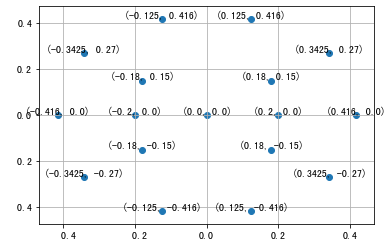

In [15]:
x_point = positions['X'].to_numpy()
y_point = positions['Y'].to_numpy()
plt.scatter(x_point,y_point)

for a, b in zip(x_point,y_point):
    plt.text(a, b, (a,b),ha='center', va='bottom', fontsize=10)

plt.grid()
plt.show()


In [16]:
x_point

array([-0.125 ,  0.125 , -0.2   ,  0.2   , -0.3425,  0.3425, -0.125 ,
        0.125 , -0.3425,  0.3425, -0.18  ,  0.18  , -0.416 ,  0.416 ,
       -0.18  ,  0.18  ,  0.    ])

In [17]:
y_point

array([-0.416, -0.416,  0.   ,  0.   ,  0.27 ,  0.27 ,  0.416,  0.416,
       -0.27 , -0.27 , -0.15 , -0.15 ,  0.   ,  0.   ,  0.15 ,  0.15 ,
        0.   ])

In graphic order: line to line, left to right:

[1,2,9,10,11,12,13,3,4,14,15,16,5,6,7,8]

['Fp1', 'Fp2', 'F7', 'F8', 'F3', 'F4', 'T3', 'C3', 'C4', 'T4', 'P3', 'P4', 'T5', 'T6', 'O1', 'O2']

So in txt order:

[7,8,3,4,9,10,1,2,5,6,15,16,13,14,11,12]

['ch7','ch8','ch3','ch4','ch9','ch10','ch1','ch2','ch5','ch6','ch15','ch16','ch13','ch14','ch11','ch12']

[ 'O1', 'O2', 'C3','C4','F7','F8','Fp1','Fp2','T5','T6','P3','P4','T3','T4','F3','F4']


Now we find the right name et channel for the position. so add those information in the txt file:


In [18]:
positions['channel_index'] = ['ch7','ch8','ch3','ch4','ch9','ch10','ch1','ch2','ch5','ch6','ch15','ch16','ch13','ch14','ch11','ch12','Cz']
positions['channel_name'] = [ 'O1', 'O2', 'C3','C4','F7','F8','Fp1','Fp2','T5','T6','P3','P4','T3','T4','F3','F4','Cz']

In [35]:
# don't need to re do this

# positions_need = positions.iloc[:16,:]

# positions_need.to_csv("./data/electrode_positions.csv")

Other ways

Official standard 3-d positions in MNE
https://mne.tools/stable/auto_examples/visualization/eeglab_head_sphere.html#sphx-glr-auto-examples-visualization-eeglab-head-sphere-py

### Generation images

We could use the ways of the paper(Learning Representations from EEG with Deep Recurrent-Convolutional Neural Networks), generate the EEG movies by our own.

But I will reserve this method for now, only come back if we need to.


### MNE images

Python MNE package can produce the EEG brain image directly, and I will test this in the following part.

standard 10_20 https://www.diytdcs.com/2012/07/1020-system-electrode-distances/

useful links for topo plot:

https://mne.tools/stable/generated/mne.viz.plot_topomap.html

https://mne.tools/stable/auto_tutorials/io/30_reading_fnirs_data.html#sphx-glr-auto-tutorials-io-30-reading-fnirs-data-py

https://mne.tools/stable/auto_examples/visualization/evoked_topomap.html#sphx-glr-auto-examples-visualization-evoked-topomap-py



Other useful links for future processing:

https://mne.tools/stable/auto_examples/index.html

https://mne.tools/stable/auto_examples/preprocessing/css.html#sphx-glr-auto-examples-preprocessing-css-py

https://mne.tools/stable/auto_examples/preprocessing/eeg_csd.html#sphx-glr-auto-examples-preprocessing-eeg-csd-py

https://mne.tools/stable/auto_examples/preprocessing/find_ref_artifacts.html#sphx-glr-auto-examples-preprocessing-find-ref-artifacts-py

https://mne.tools/stable/auto_examples/decoding/decoding_csp_eeg.html#sphx-glr-auto-examples-decoding-decoding-csp-eeg-py

In [19]:
from sklearn.preprocessing import MinMaxScaler
band_name = ["δ" , "θ" , "α" , "β" , "γ"]

In [20]:
def show_topo(data , vmin = 0 , vmax = 1 , contours = 6 , cmap = 'jet'):
    # plt.figure(figsize = (10 , 10))
    # data should be 2-d
    data = data.reshape(16 , 1)
    # our BCI channel names
    ch_names = ['Fp1', 'Fp2', 'C3', 'C4', 'T5', 'T6', 'O1', 'O2', 'F7', 'F8', 'F3', 'F4', 'T3', 'T4', 'P3', 'P4']
    # create info
    info = mne.create_info(ch_names = ch_names , sfreq = 125 , ch_types = 'eeg')
    # create evoke object
    evoked = mne.EvokedArray(data , info)
    # set montage, in our case alyways 10_20
    biosemi_montage = 'standard_1020'
    evoked.set_montage(biosemi_montage)
    # print(evoked.info)
    # show topo map
    ax , countour = mne.viz.plot_topomap(evoked.data[: , 0] ,
                                        evoked.info , show = False , cmap = cmap , 
                                        vmin = vmin , vmax = vmax , contours = contours) 
    return ax , countour

In [21]:
bp_result = np.transpose(np.array(example_pb))
bp_result.shape

(5, 16)

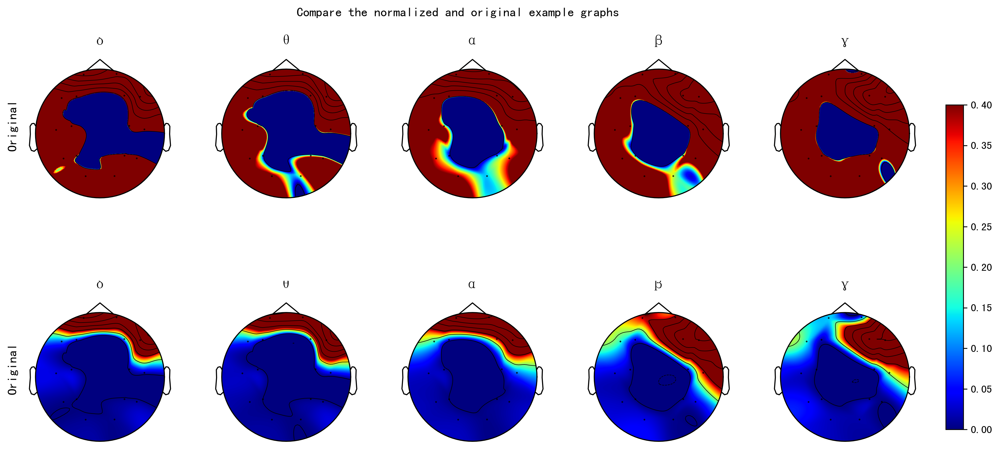

In [26]:
fig = plt.figure(figsize = (15 , 7) , dpi = 300)
events = ['Original','Normalized']

for j in range(2):
    for i in range(5):
        data = bp_result[i,:]
        ax = plt.subplot(2 , 5 ,j*5+i+1 )
        if j == 0:
            aximage , countour = show_topo(data , vmin = 0 , vmax = 0.4)
        else:
            mm = MinMaxScaler()
            mm_data = mm.fit_transform(np.array(data).reshape(16,1))
            aximage , countour = show_topo(mm_data , vmin = 0 , vmax = 0.4)
        ax.set_title(band_name[i] , fontsize = 15)
        if i == 0:
            ax.set_ylabel(events[j] , rotation = 90 , size = 'large')
# colorbar left bottom width height 
l = 0.92
b = 0.2
w = 0.015
h = 0.6
# set colorbar position；
rect = [l,b,w,h] 
cbar_ax = fig.add_axes(rect) 
plt.colorbar(aximage, cax=cbar_ax)
fig.suptitle("Compare the normalized and original example graphs" )
plt.show()

It seems that normalization is useful and we can easily find the difference.

Now try to plot the average of all data, one letter, in a different method.

Besides, we start from storing those power band info for usage in future.


In [27]:
feature_path = "./data/EEG_features_Lintao/"  
bp_feature_path = feature_path + "band_power/"

Do not run the codes below unless it's your first time run this notebook locally.

Read those text files and plot topo map!

### one average letter

In [28]:
filename_list = os.listdir(bp_feature_path)
# filename_list

In [29]:
filename_list = os.listdir(bp_feature_path)
path_list = list()
bp_data_dict = dict()
strr_list = list()

for item in filename_list:
    path_list.append(os.path.join(bp_feature_path, item))
    strr = item.split('_bp')[0]
    strr_list.append(strr)


for i in range(len(path_list)):
    with open(path_list[i], 'r') as current:
        raw = current.readlines() 
        bp = list()
        for item in raw:
            cc = list()
            item = item.split("\t")[2:-1]
            for j in item:
                cc.append(eval(j))
            bp.append(cc)
                  
        bp_data_dict[strr_list[i]] = bp 

In [30]:
bp_data_dict.keys()
# bp_data_dict['fft_alphabet_imagination'][0]

dict_keys(['fft_alphabet_imagination', 'fft_alphabet_vision', 'fft_asl_imagination', 'fft_asl_vision', 'multitaper_alphabet_imagination', 'multitaper_alphabet_vision', 'multitaper_asl_imagination', 'multitaper_asl_vision', 'welch_alphabet_imagination', 'welch_alphabet_vision', 'welch_asl_imagination', 'welch_asl_vision'])

In [31]:
# all labels are same order
labels = list()
for item in alphabet_vision:
    labels.append(item[-1])

In [32]:
v_indexs = list()
for i in range(len(labels)):
    if labels[i] == 'V':
        v_indexs.append(i)

# average v bp
welch_alphabet_vision_bp = list()
fft_alphabet_vision_bp = list()
multitaper_alphabet_vision_bp = list()
for index in v_indexs:
    welch_alphabet_vision_bp.append(bp_data_dict['welch_alphabet_vision'][index])
    fft_alphabet_vision_bp.append(bp_data_dict['fft_alphabet_vision'][index])
    multitaper_alphabet_vision_bp.append(bp_data_dict['multitaper_alphabet_vision'][index])
welch_alphabet_vision_bp = np.array(welch_alphabet_vision_bp)
fft_alphabet_vision_bp = np.array(fft_alphabet_vision_bp)
multitaper_alphabet_vision_bp = np.array(multitaper_alphabet_vision_bp)
welch_alphabet_vision_bp.shape

(32, 16, 5)

In [33]:
# v_indexs

In [34]:
welch_avg_v = np.mean(welch_alphabet_vision_bp,axis=0, keepdims=False)
fft_avg_v = np.mean(fft_alphabet_vision_bp,axis=0, keepdims=False)
multitaper_avg_v = np.mean(multitaper_alphabet_vision_bp,axis=0, keepdims=False)

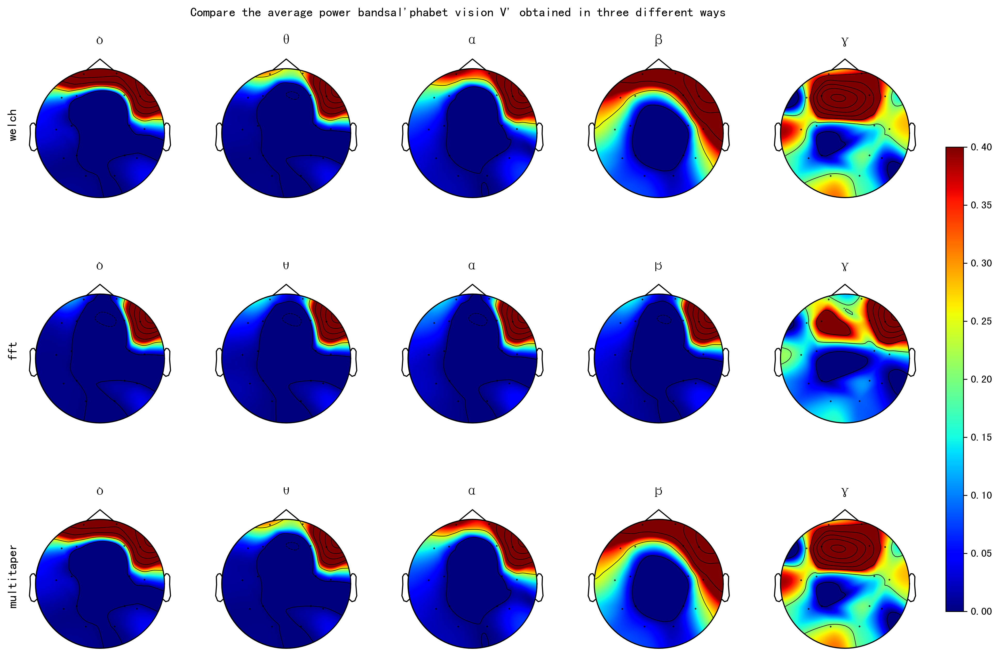

In [36]:
events = ['welch', 'fft', 'multitaper'] 
fig = plt.figure(figsize = (15, 10) , dpi = 300)
bp = [welch_avg_v,fft_avg_v,multitaper_avg_v]

for j in range(len(events)):
    bp_result = np.transpose(bp[j])

    for i in range(5):
        # print(bp_result.shape)
        data = bp_result[i,:]
        ax = plt.subplot(3 , 5 ,j * 5 + i + 1 )
        mm = MinMaxScaler()
        mm_data = mm.fit_transform(np.array(data).reshape(16,1))
        aximage , countour = show_topo(mm_data , vmin = 0 , vmax = 0.4)
        ax.set_title(band_name[i] , fontsize = 15)
        if i == 0:
            ax.set_ylabel(events[j] , rotation = 90 , size = 'large')
# colorbar left bottom width height 
l = 0.92
b = 0.2
w = 0.015
h = 0.6
# set colorbar position；
rect = [l,b,w,h] 
cbar_ax = fig.add_axes(rect) 
plt.colorbar(aximage, cax=cbar_ax)
fig.suptitle("Compare the average power band 'alphabet vision V' obtained in three different ways")
plt.show()

# plt.savefig("result/" + ".png")

Compare differences by subtracting values

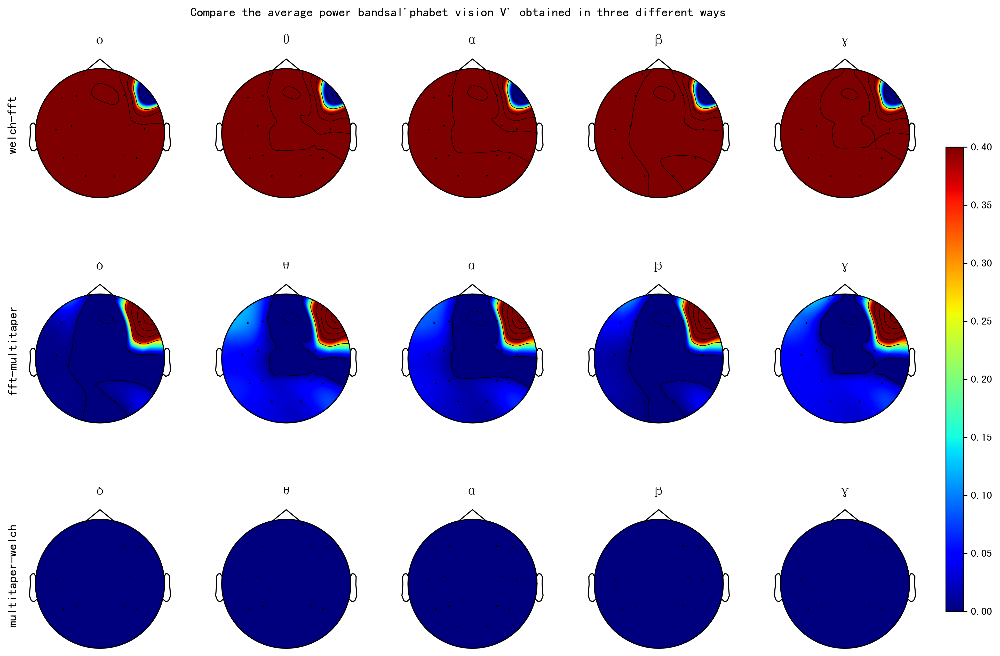

In [37]:
events = ['welch-fft', 'fft-multitaper', 'multitaper-welch'] 
fig = plt.figure(figsize = (15, 10) , dpi = 300)
bp = [welch_avg_v-fft_avg_v,fft_avg_v-multitaper_avg_v,multitaper_avg_v-welch_avg_v]

for j in range(len(events)):
    bp_result = np.transpose(bp[j])

    for i in range(5):
        # print(bp_result.shape)
        data = bp_result[i,:]
        ax = plt.subplot(3 , 5 ,j * 5 + i + 1 )
        mm = MinMaxScaler()
        mm_data = mm.fit_transform(np.array(data).reshape(16,1))
        aximage , countour = show_topo(mm_data , vmin = 0 , vmax = 0.4)
        ax.set_title(band_name[i] , fontsize = 15)
        if i == 0:
            ax.set_ylabel(events[j] , rotation = 90 , size = 'large')
# colorbar left bottom width height 
l = 0.92
b = 0.2
w = 0.015
h = 0.6
# set colorbar position；
rect = [l,b,w,h] 
cbar_ax = fig.add_axes(rect) 
plt.colorbar(aximage, cax=cbar_ax)
fig.suptitle("Compare the average power bandsal'phabet vision V' obtained in three different ways" )
plt.show()

# plt.savefig("result/" + ".png")

Multitaper and welch are basically same, fft is the different, we can compare the performance of the three in model part

In [38]:
# average v bp
welch_alphabet_vision_bp = list()
welch_alphabet_img_bp = list()
welch_asl_vision_bp = list()
welch_asl_img_bp = list()
for index in v_indexs:
    welch_alphabet_vision_bp.append(bp_data_dict['welch_alphabet_vision'][index])
    welch_alphabet_img_bp.append(bp_data_dict['welch_alphabet_imagination'][index])
    welch_asl_vision_bp.append(bp_data_dict['welch_asl_vision'][index])
    welch_asl_img_bp.append(bp_data_dict['welch_asl_imagination'][index])
    
welch_alphabet_vision_bp = np.array(welch_alphabet_vision_bp)
welch_alphabet_img_bp = np.array(welch_alphabet_img_bp)
welch_asl_vision_bp = np.array(welch_asl_vision_bp)
welch_asl_img_bp = np.array(welch_asl_img_bp)


avg_v_alpha_vision = np.mean(welch_alphabet_vision_bp,axis=0, keepdims=False)
avg_v_alpha_img = np.mean(welch_alphabet_img_bp,axis=0, keepdims=False)
avg_v_asl_vision = np.mean(welch_asl_vision_bp,axis=0, keepdims=False)
avg_v_asl_img = np.mean(welch_asl_img_bp,axis=0, keepdims=False)

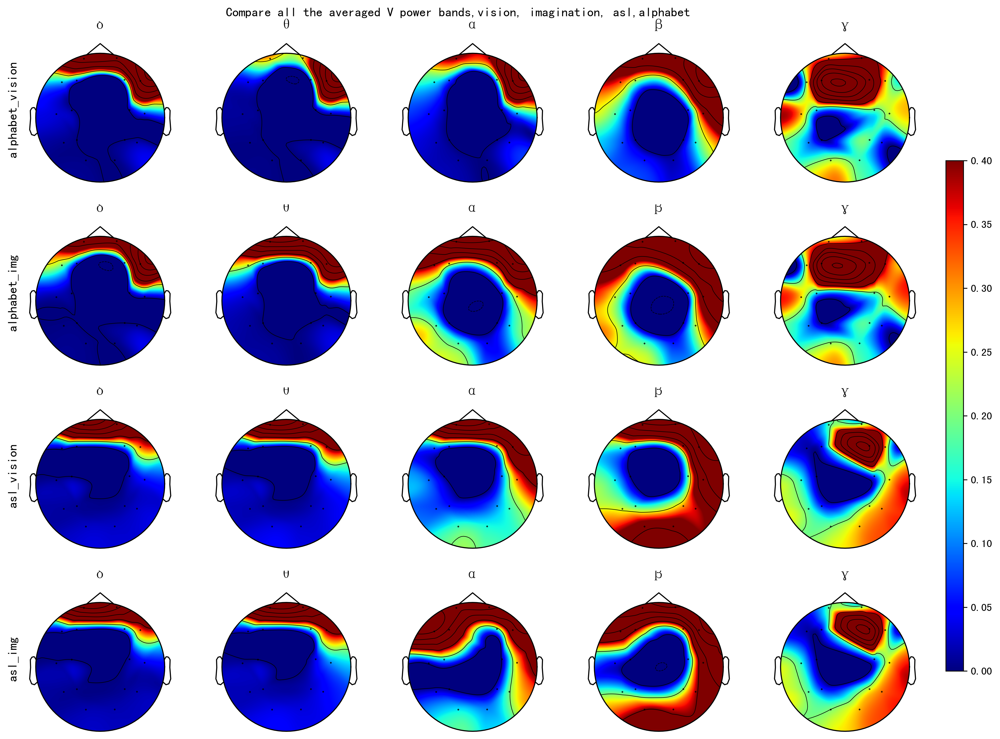

In [39]:
events = ['alphabet_vision', 'alphabet_img', 'asl_vision', 'asl_img'] 
fig = plt.figure(figsize = (15, 11) , dpi = 300)
bp = [avg_v_alpha_vision,avg_v_alpha_img,avg_v_asl_vision,avg_v_asl_img]

for j in range(len(events)):
    bp_result = np.transpose(bp[j])

    for i in range(5):
        # print(bp_result.shape)
        data = bp_result[i,:]
        ax = plt.subplot(4 , 5 ,j * 5 + i + 1 )
        mm = MinMaxScaler()
        mm_data = mm.fit_transform(np.array(data).reshape(16,1))
        aximage , countour = show_topo(mm_data , vmin = 0 , vmax = 0.4)
        ax.set_title(band_name[i] , fontsize = 15)
        if i == 0:
            ax.set_ylabel(events[j] , rotation = 90 , size = 'large')
# colorbar left bottom width height 
l = 0.92
b = 0.2
w = 0.015
h = 0.6
# set colorbar position；
rect = [l,b,w,h] 
cbar_ax = fig.add_axes(rect) 
plt.colorbar(aximage, cax=cbar_ax)
fig.suptitle("Compare all the averaged V power bands,vision, imagination, asl,alphabet" )
plt.show()

# plt.savefig("result/" + ".png")

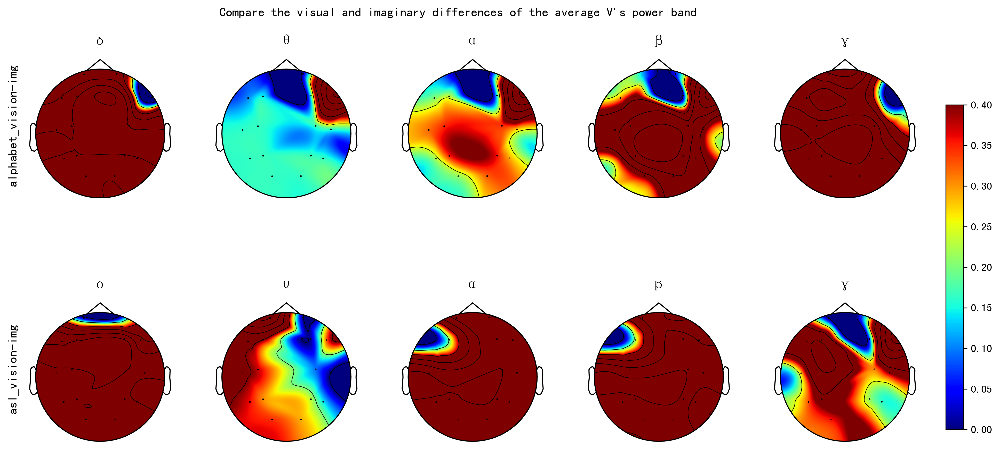

In [40]:
events = ['alphabet_vision-img',  'asl_vision-img'] 
fig = plt.figure(figsize = (15, 7) , dpi = 300)
bp = [avg_v_alpha_vision-avg_v_alpha_img,avg_v_asl_vision-avg_v_asl_img]

for j in range(len(events)):
    bp_result = np.transpose(bp[j])

    for i in range(5):
        # print(bp_result.shape)
        data = bp_result[i,:]
        ax = plt.subplot(2 , 5 ,j * 5 + i + 1 )
        mm = MinMaxScaler()
        mm_data = mm.fit_transform(np.array(data).reshape(16,1))
        aximage , countour = show_topo(mm_data , vmin = 0 , vmax = 0.4)
        ax.set_title(band_name[i] , fontsize = 15)
        if i == 0:
            ax.set_ylabel(events[j] , rotation = 90 , size = 'large')
# colorbar left bottom width height 
l = 0.92
b = 0.2
w = 0.015
h = 0.6
# set colorbar position；
rect = [l,b,w,h] 
cbar_ax = fig.add_axes(rect) 
plt.colorbar(aximage, cax=cbar_ax)
fig.suptitle("Compare the visual and imaginary differences of the average V's power band" )
plt.show()

# plt.savefig("result/" + ".png")

The power band of vision and imagination, we can find a lot different values(for v, we will compare all avg in next small part)

In [41]:
# compare v with w, see if there some different

w_indexs = list()
for i in range(len(labels)):
    
    if labels[i] == 'W':
        w_indexs.append(i)

# average w bp
welch_alphabet_vision_bp_w = list()
welch_alphabet_img_bp_w = list()
welch_asl_vision_bp_w = list()
welch_asl_img_bp_w = list()
for index in w_indexs:
    welch_alphabet_vision_bp_w.append(bp_data_dict['welch_alphabet_vision'][index])
    welch_alphabet_img_bp_w.append(bp_data_dict['welch_alphabet_imagination'][index])
    welch_asl_vision_bp_w.append(bp_data_dict['welch_asl_vision'][index])
    welch_asl_img_bp_w.append(bp_data_dict['welch_asl_imagination'][index])
    
welch_alphabet_vision_bp_w = np.array(welch_alphabet_vision_bp_w)
welch_alphabet_img_bp_w = np.array(welch_alphabet_img_bp_w)
welch_asl_vision_bp_w = np.array(welch_asl_vision_bp_w)
welch_asl_img_bp_w = np.array(welch_asl_img_bp_w)


avg_w_alpha_vision = np.mean(welch_alphabet_vision_bp_w,axis=0, keepdims=False)
avg_w_alpha_img = np.mean(welch_alphabet_img_bp_w,axis=0, keepdims=False)
avg_w_asl_vision = np.mean(welch_asl_vision_bp_w,axis=0, keepdims=False)
avg_w_asl_img = np.mean(welch_asl_img_bp_w,axis=0, keepdims=False)

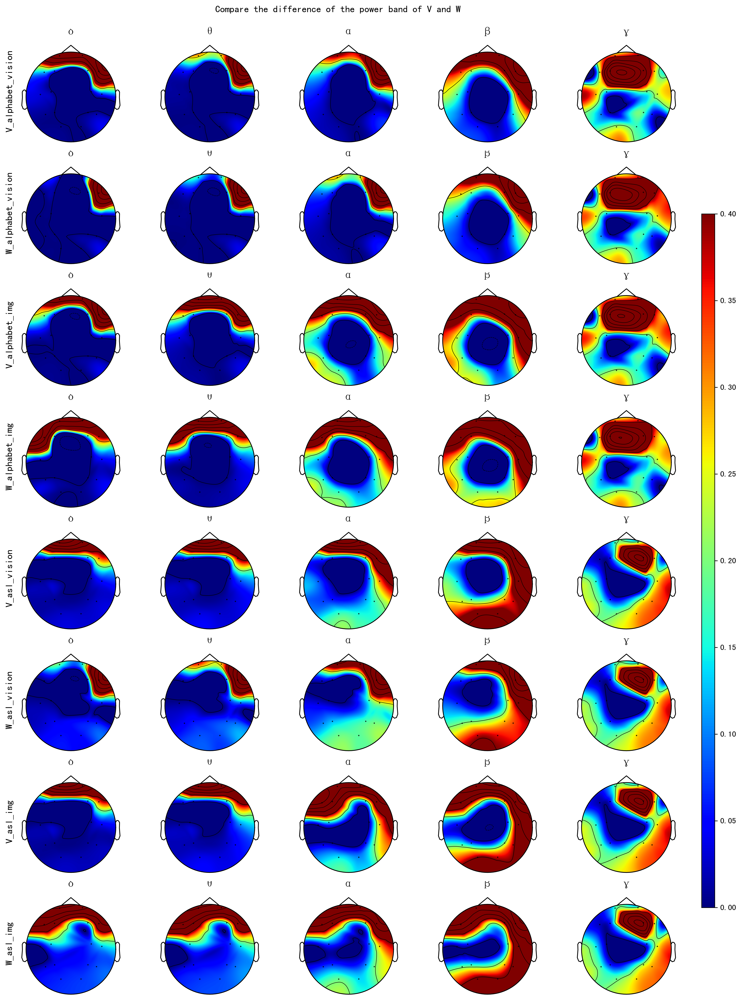

In [42]:
events = ['V_alphabet_vision','W_alphabet_vision', 'V_alphabet_img','W_alphabet_img', 'V_asl_vision', 'W_asl_vision', 'V_asl_img','W_asl_img'] 
fig = plt.figure(figsize = (15, 20) , dpi = 300)
bp = [avg_v_alpha_vision,avg_w_alpha_vision, avg_v_alpha_img,avg_w_alpha_img, 
      avg_v_asl_vision,avg_w_asl_vision, avg_v_asl_img, avg_w_asl_img]

for j in range(len(events)):
    bp_result = np.transpose(bp[j])

    for i in range(5):
        # print(bp_result.shape)
        data = bp_result[i,:]
        ax = plt.subplot(8 , 5 ,j * 5 + i + 1 )
        mm = MinMaxScaler()
        mm_data = mm.fit_transform(np.array(data).reshape(16,1))
        aximage , countour = show_topo(mm_data , vmin = 0 , vmax = 0.4)
        ax.set_title(band_name[i] , fontsize = 15)
        if i == 0:
            ax.set_ylabel(events[j] , rotation = 90 , size = 'large')
# colorbar left bottom width height 
l = 0.92
b = 0.2
w = 0.015
h = 0.6
# set colorbar position；
rect = [l,b,w,h] 
cbar_ax = fig.add_axes(rect) 
plt.colorbar(aximage, cax=cbar_ax)
fig.suptitle("Compare the difference of the power band of V and W" )
plt.show()

# plt.savefig("result/" + ".png")

Compare the difference

In [43]:
# avg_v_alpha_vision-avg_w_alpha_vision

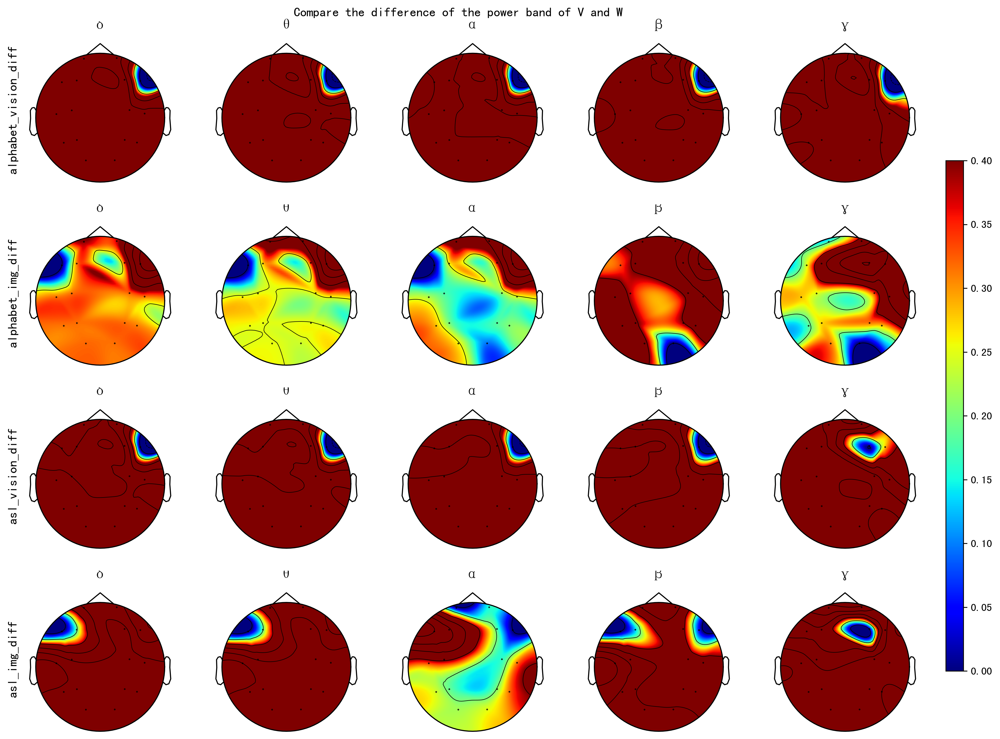

In [44]:
events = ['alphabet_vision_diff', 'alphabet_img_diff', 'asl_vision_diff', 'asl_img_diff'] 
fig = plt.figure(figsize = (15, 11) , dpi = 300)
bp = [avg_v_alpha_vision-avg_w_alpha_vision, avg_v_alpha_img-avg_w_alpha_img, 
      avg_v_asl_vision-avg_w_asl_vision, avg_v_asl_img- avg_w_asl_img]

for j in range(len(events)):
    bp_result = np.transpose(bp[j])

    for i in range(5):
        # print(bp_result.shape)
        data = bp_result[i,:]
        ax = plt.subplot(4 , 5 ,j * 5 + i + 1 )
        mm = MinMaxScaler()
        mm_data = mm.fit_transform(np.array(data).reshape(16,1))
        aximage , countour = show_topo(mm_data , vmin = 0 , vmax = 0.4)
        ax.set_title(band_name[i] , fontsize = 15)
        if i == 0:
            ax.set_ylabel(events[j] , rotation = 90 , size = 'large')
# colorbar left bottom width height 
l = 0.92
b = 0.2
w = 0.015
h = 0.6
# set colorbar position；
rect = [l,b,w,h] 
cbar_ax = fig.add_axes(rect) 
plt.colorbar(aximage, cax=cbar_ax)
fig.suptitle("Compare the difference of the power band of V and W" )
plt.show()

# plt.savefig("result/" + ".png")

We could also find the difference between two different letters, we could compare other values  for example v and a?

In [45]:
a_indexs = list()
for i in range(len(labels)):
    
    if labels[i] == 'A':
        a_indexs.append(i)

# average a bp
welch_alphabet_vision_bp_a = list()
welch_alphabet_img_bp_a = list()
welch_asl_vision_bp_a = list()
welch_asl_img_bp_a = list()
for index in a_indexs:
    welch_alphabet_vision_bp_a.append(bp_data_dict['welch_alphabet_vision'][index])
    welch_alphabet_img_bp_a.append(bp_data_dict['welch_alphabet_imagination'][index])
    welch_asl_vision_bp_a.append(bp_data_dict['welch_asl_vision'][index])
    welch_asl_img_bp_a.append(bp_data_dict['welch_asl_imagination'][index])
    
welch_alphabet_vision_bp_a = np.array(welch_alphabet_vision_bp_a)
welch_alphabet_img_bp_a = np.array(welch_alphabet_img_bp_a)
welch_asl_vision_bp_a = np.array(welch_asl_vision_bp_a)
welch_asl_img_bp_a = np.array(welch_asl_img_bp_a)


avg_a_alpha_vision = np.mean(welch_alphabet_vision_bp_a,axis=0, keepdims=False)
avg_a_alpha_img = np.mean(welch_alphabet_img_bp_a,axis=0, keepdims=False)
avg_a_asl_vision = np.mean(welch_asl_vision_bp_a,axis=0, keepdims=False)
avg_a_asl_img = np.mean(welch_asl_img_bp_a,axis=0, keepdims=False)

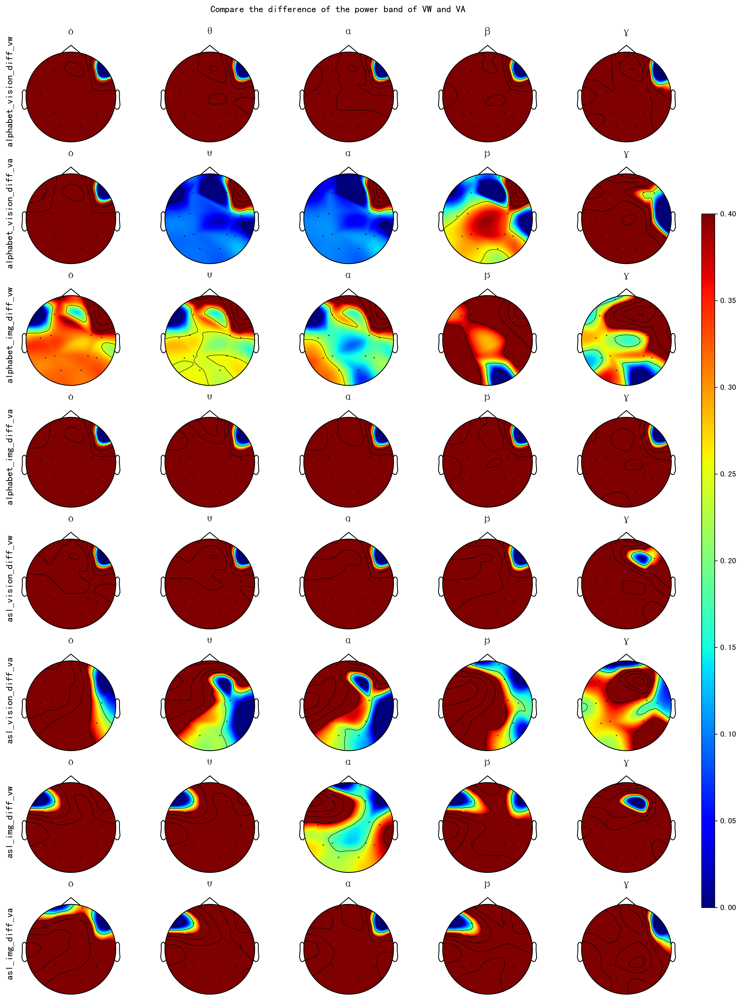

In [46]:
events = ['alphabet_vision_diff_vw','alphabet_vision_diff_va', 'alphabet_img_diff_vw', 'alphabet_img_diff_va',
          'asl_vision_diff_vw','asl_vision_diff_va', 'asl_img_diff_vw', 'asl_img_diff_va'] 
fig = plt.figure(figsize = (15, 20) , dpi = 300)
bp = [avg_v_alpha_vision-avg_w_alpha_vision, avg_v_alpha_vision-avg_a_alpha_vision, avg_v_alpha_img-avg_w_alpha_img, avg_v_alpha_img-avg_a_alpha_img,
      avg_v_asl_vision-avg_w_asl_vision,avg_v_asl_vision-avg_a_asl_vision, avg_v_asl_img- avg_w_asl_img,avg_v_asl_img- avg_a_asl_img]

for j in range(len(events)):
    bp_result = np.transpose(bp[j])

    for i in range(5):
        # print(bp_result.shape)
        data = bp_result[i,:]
        ax = plt.subplot(8 , 5 ,j * 5 + i + 1 )
        mm = MinMaxScaler()
        mm_data = mm.fit_transform(np.array(data).reshape(16,1))
        aximage , countour = show_topo(mm_data , vmin = 0 , vmax = 0.4)
        ax.set_title(band_name[i] , fontsize = 15)
        if i == 0:
            ax.set_ylabel(events[j] , rotation = 90 , size = 'large')
# colorbar left bottom width height 
l = 0.92
b = 0.2
w = 0.015
h = 0.6
# set colorbar position；
rect = [l,b,w,h] 
cbar_ax = fig.add_axes(rect) 
plt.colorbar(aximage, cax=cbar_ax)
fig.suptitle("Compare the difference of the power band of VW and VA" )
plt.show()

# plt.savefig("result/" + ".png")

### Paired test, test for significant difference 

T value  P value (to be continued)

In [47]:
from scipy import stats
t , p_two = stats.ttest_1samp(mm_data , 0)

### all average

avg all

avg diff

In [49]:
welch_alphabet_vision_bp = np.array(bp_data_dict['welch_alphabet_vision'])
welch_alphabet_img_bp = np.array(bp_data_dict['welch_alphabet_imagination'])
welch_asl_vision_bp = np.array(bp_data_dict['welch_asl_vision'])
welch_asl_img_bp = np.array(bp_data_dict['welch_asl_imagination'])


avg_alpha_vision = np.mean(welch_alphabet_vision_bp,axis=0, keepdims=False)
avg_alpha_img = np.mean(welch_alphabet_img_bp,axis=0, keepdims=False)
avg_asl_vision = np.mean(welch_asl_vision_bp,axis=0, keepdims=False)
avg_asl_img = np.mean(welch_asl_img_bp,axis=0, keepdims=False)

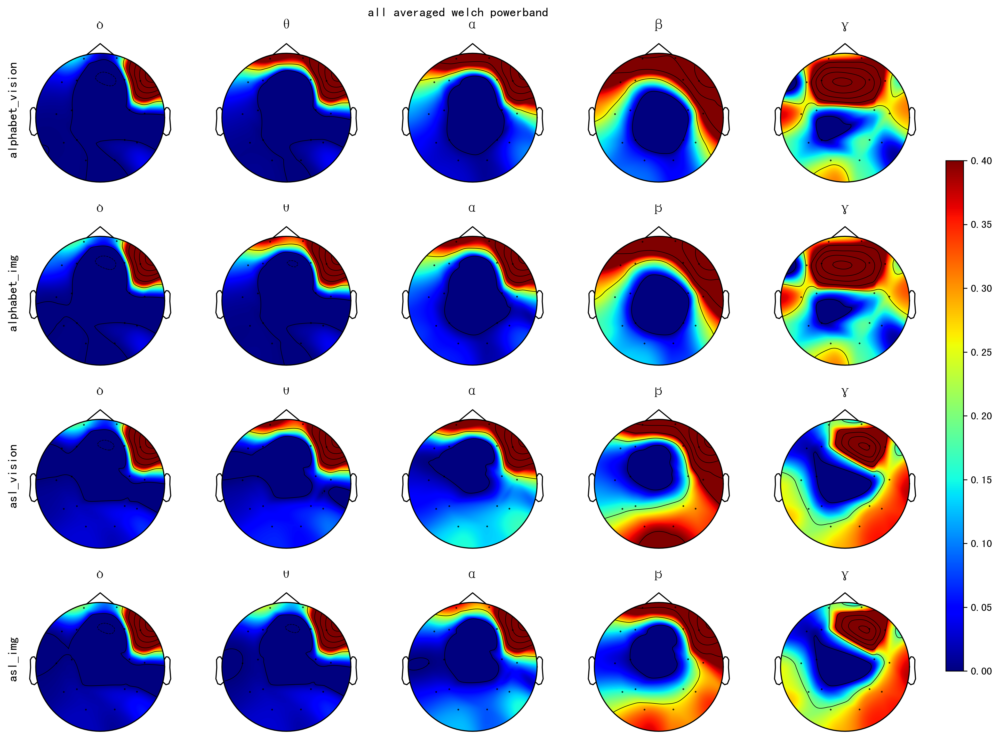

In [50]:
events = ['alphabet_vision', 'alphabet_img', 'asl_vision', 'asl_img'] 
fig = plt.figure(figsize = (15, 11) , dpi = 300)
bp = [avg_alpha_vision,avg_alpha_img,avg_asl_vision,avg_asl_img]

for j in range(len(events)):
    bp_result = np.transpose(bp[j])

    for i in range(5):
        # print(bp_result.shape)
        data = bp_result[i,:]
        ax = plt.subplot(4 , 5 ,j * 5 + i + 1 )
        mm = MinMaxScaler()
        mm_data = mm.fit_transform(np.array(data).reshape(16,1))
        aximage , countour = show_topo(mm_data , vmin = 0 , vmax = 0.4)
        ax.set_title(band_name[i] , fontsize = 15)
        if i == 0:
            ax.set_ylabel(events[j] , rotation = 90 , size = 'large')
# colorbar left bottom width height 
l = 0.92
b = 0.2
w = 0.015
h = 0.6
# set colorbar position；
rect = [l,b,w,h] 
cbar_ax = fig.add_axes(rect) 
plt.colorbar(aximage, cax=cbar_ax)
fig.suptitle("all averaged welch powerband" )
plt.show()

# plt.savefig("result/" + ".png")

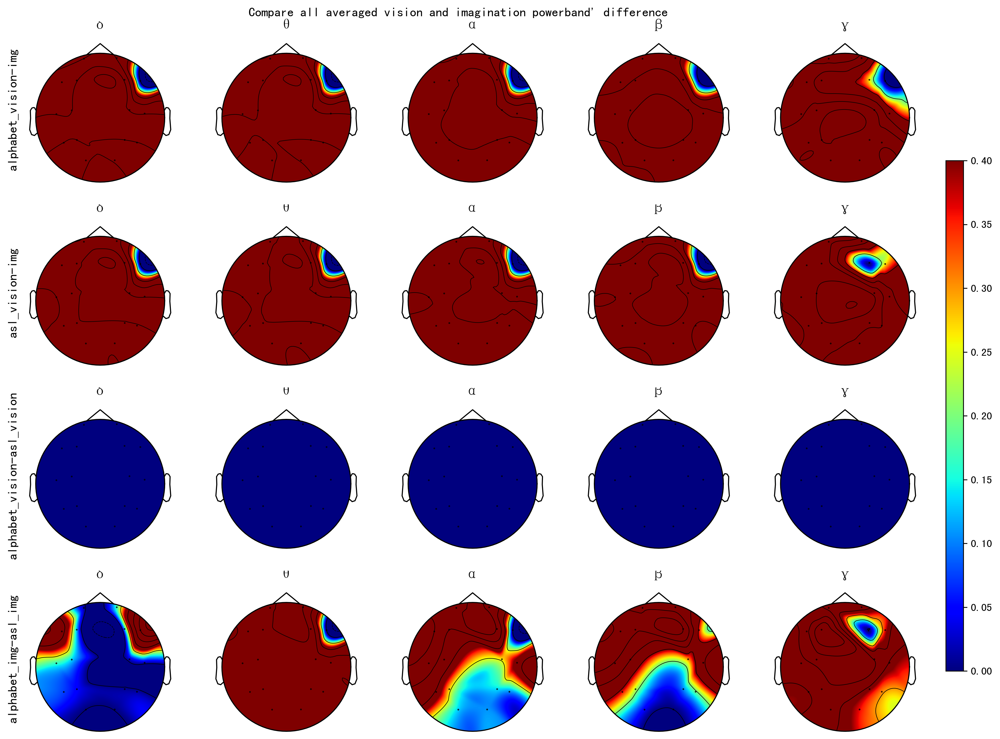

In [51]:
events = ['alphabet_vision-img',  'asl_vision-img','alphabet_vision-asl_vision','alphabet_img-asl_img'] 
fig = plt.figure(figsize = (15, 11) , dpi = 300)
bp = [avg_alpha_vision-avg_alpha_img,avg_asl_vision-avg_asl_img, avg_alpha_vision-avg_alpha_vision, avg_alpha_img-avg_asl_img]

for j in range(len(events)):
    bp_result = np.transpose(bp[j])

    for i in range(5):
        # print(bp_result.shape)
        data = bp_result[i,:]
        ax = plt.subplot(4 , 5 ,j * 5 + i + 1 )
        mm = MinMaxScaler()
        mm_data = mm.fit_transform(np.array(data).reshape(16,1))
        aximage , countour = show_topo(mm_data , vmin = 0 , vmax = 0.4)
        ax.set_title(band_name[i] , fontsize = 15)
        if i == 0:
            ax.set_ylabel(events[j] , rotation = 90 , size = 'large')
# colorbar left bottom width height 
l = 0.92
b = 0.2
w = 0.015
h = 0.6
# set colorbar position；
rect = [l,b,w,h] 
cbar_ax = fig.add_axes(rect) 
plt.colorbar(aximage, cax=cbar_ax)
fig.suptitle("Compare all averaged vision and imagination powerband' difference" )
plt.show()

# plt.savefig("result/" + ".png")

### time slices

* time slices for bp

* time slices for avg value(real time domain value)

In [52]:
# example

In [53]:
def power_band_timeslice(data,time_step=4, sf=125, method='welch', window_sec=None, relative=False):
    # data : 2-d array
    result = list()
    for i in range(data.shape[-1]):
        
        ch = data[:,i]
        each_slice_length = len(ch) // time_step
        bp = list()
        for j in range(time_step):

            if j!= time_step-1:
                current = ch[j*each_slice_length:each_slice_length *(j+1)]
                current = one_signal_band_power(current, sf=sf, method=method, window_sec=window_sec, relative=relative)
            
            else:
                current = ch[j*each_slice_length:]
                current = one_signal_band_power(current, sf=sf, method=method, window_sec=window_sec, relative=relative)
            bp.append(current)
        result.append(bp)
    
    return result       

Add this function in tools.py

In [54]:
example_bp_timeslice = power_band_timeslice(np.array(example), method='welch')
example_bp_timeslice = np.transpose(np.array(example_bp_timeslice),(1,2,0))
example_bp_timeslice[3].shape

(5, 16)

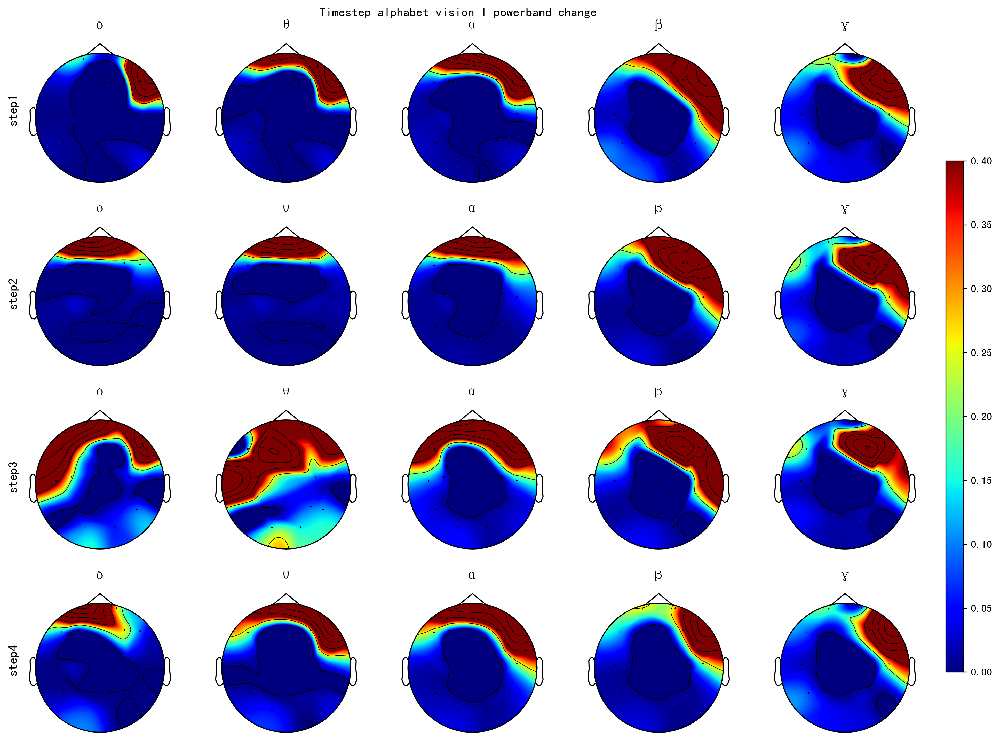

In [55]:
# It seems that normalization is useful
fig = plt.figure(figsize = (15 , 11) , dpi = 300)
events = ['step1','step2','step3','step4']

for j in range(len(events)):
    current = example_bp_timeslice[j]
    for i in range(5):
        data = current[i,:]
        ax = plt.subplot(4 , 5 ,5*j+i+1 )
        mm = MinMaxScaler()
        mm_data = mm.fit_transform(np.array(data).reshape(16,1))
        aximage , countour = show_topo(mm_data , vmin = 0 , vmax = 0.4)
        ax.set_title(band_name[i] , fontsize = 15)
        if i == 0:
            ax.set_ylabel(events[j] , rotation = 90 , size = 'large')
# colorbar left bottom width height 
l = 0.92
b = 0.2
w = 0.015
h = 0.6
# set colorbar position；
rect = [l,b,w,h] 
cbar_ax = fig.add_axes(rect) 
plt.colorbar(aximage, cax=cbar_ax)
fig.suptitle("Timestep alphabet vision I powerband change" )
plt.show()

# plt.savefig("result/" + ".png")

# 3 / 4 = 0.73s 

So far, we get a lot useful information from those images, and we get some ways to generate features:

1. pure power band(three methods)
2. generate own EEG image with positions(should be adapted)
3. use MNE EEG images
4. consider time features, use time step power band
5. consider time features, use time step power band images.

Other REF for topo plot

https://cxyzjd.com/article/weixin_44290152/123351819#_190

https://www.its203.com/article/LiDLMU/109498705

https://python.hotexamples.com/fr/examples/mne.viz/-/plot_topomap/python-plot_topomap-function-examples.html

